### Detection of credit cards transaction fraud

The goal of this project is to train the system to recognize fraud transactions among credit cards users, so that customers are not charged for items that they did not purchase.

From [Kaggle](https://www.kaggle.com/mlg-ulb/creditcardfraud).
The datasets contains transactions made by credit cards in September 2013 by european cardholders. 
This dataset presents transactions that occurred in two days, where we have 492 frauds out of 284,807 transactions. The dataset is highly unbalanced, the positive class (frauds) account for 0.172% of all transactions.

It contains only numerical input variables which are the result of a PCA transformation. Unfortunately, due to confidentiality issues, we cannot provide the original features and more background information about the data. Features V1, V2, … V28 are the principal components obtained with PCA, the only features which have not been transformed with PCA are 'Time' and 'Amount'. Feature 'Time' contains the seconds elapsed between each transaction and the first transaction in the dataset. The feature 'Amount' is the transaction Amount, this feature can be used for example-dependant cost-senstive learning. Feature 'Class' is the response variable and it takes value 1 in case of fraud and 0 otherwise.

Our Goals are:

 * Understand the distribution of data.
 * Create am equal amount datasets of "Fraud" and "Non-Fraud" transactions. 
 * Determine the Classifiers we are going to use and decide which one has a higher accuracy.
 * Train classifiers
 * Define a classifier with best ROC AUC scoring to recognize fraud transactions

In [20]:
# import dependencies
import pandas as pd
import numpy as np
# scikit-learn
from sklearn.model_selection import train_test_split
from sklearn.svm import LinearSVC, SVR
from sklearn.linear_model import SGDClassifier
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.preprocessing import StandardScaler
# plotting
import matplotlib.pyplot as plt
import seaborn as sns
import plot_util
from sklearn.metrics import roc_curve, auc
# resampling
from imblearn.under_sampling import RandomUnderSampler

In [2]:
# read data
credit_cards = pd.read_csv('./data/creditcard.csv')

In [3]:
# basic descriptive stats
credit_cards.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.165980e-15,3.416908e-16,-1.373150e-15,2.086869e-15,9.604066e-16,1.490107e-15,-5.556467e-16,1.177556e-16,-2.406455e-15,...,1.656562e-16,-3.444850e-16,2.578648e-16,4.471968e-15,5.340915e-16,1.687098e-15,-3.666453e-16,-1.220404e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


The dataset consists of Time, Amount, Class and Principal Components.

In [4]:
# column types
credit_cards.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

All the columns are numerical.

In [5]:
credit_cards.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [6]:
# what is the amount of training examples and features
print(f'There are {credit_cards.shape[0]} training examples and {credit_cards.shape[1] - 1} features in the training set.') 
fraud_count = credit_cards[credit_cards.loc[:, 'Class'] == 1].shape[0]
valid_count = credit_cards[credit_cards.loc[:, 'Class'] == 0].shape[0]
print(f'Valid: {valid_count}, fraud: {fraud_count}')

There are 284807 training examples and 30 features in the training set.
Valid: 284315, fraud: 492


## Correlations 

In [7]:
# corr. Chosen standart corr coef with min observation required 
corr_matrix = credit_cards.corr(method='pearson', min_periods=1)


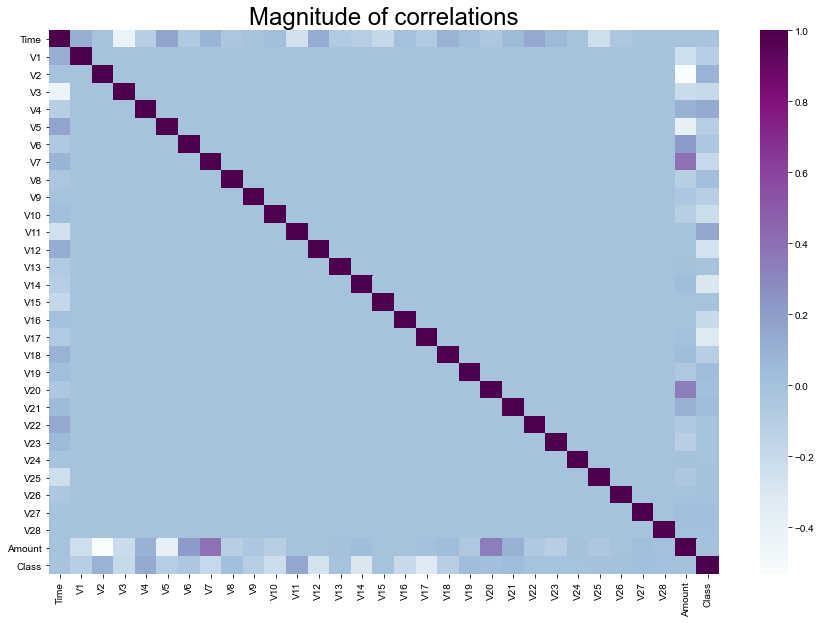

In [8]:
# function which plots heatmap
def plot_heatmap(corr_matrix):
    plt.figure(figsize=(15, 10))
    sns.heatmap(corr_matrix, cmap='BuPu')
    sns.set(font_scale=2, style='white')
    plt.title('Magnitude of correlations')
    plt.show()
plot_heatmap(corr_matrix)

This heatman illustrates that there is no correlation between PC, there is a correlation between amount and PC, Time and PC, there is a negative correlation between class and some PC. 

How fraudulent transactions look in terms of time and Amount?

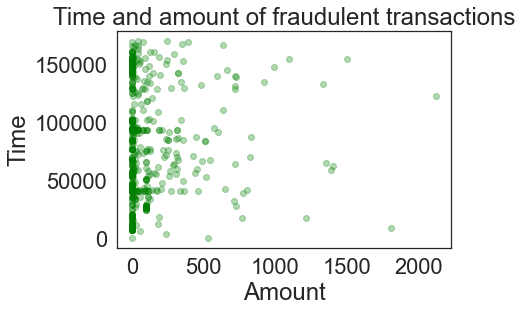

In [9]:
# the function which plots 1 class distribution
def plot_1_dim_scatter():
    fraud_transactions = credit_cards[credit_cards['Class'] == 1]
    plt.scatter(fraud_transactions[['Amount']], fraud_transactions[['Time']], alpha=0.3, c='green', cmap='viridis')
    plt.xlabel('Amount')
    plt.ylabel('Time')
    plt.title('Time and amount of fraudulent transactions')
    plt.show()
plot_1_dim_scatter()

There is no significant time differentiation but fraud trannsactions are mostly small amount according tto the plot. 

What is the shape of distributions by class?

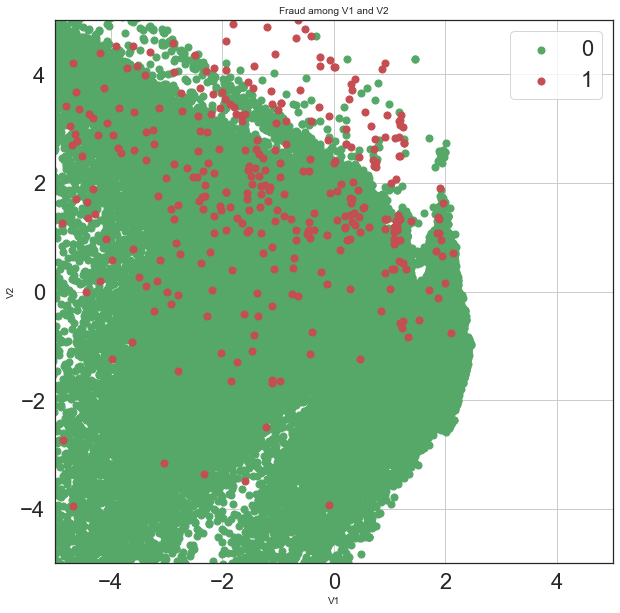

In [10]:
# function which plots scatter distr
def plot_scatter(distr):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(1,1,1)
    ax.set_xlabel('V1', fontsize = 10)
    ax.set_ylabel('V2', fontsize = 10)
    ax.set_xlim(-5, 5)
    ax.set_ylim(-5, 5)
    ax.set_title('Fraud among V1 and V2', fontsize=10)
    classes = [0, 1]
    colors = ['g', 'r']
    for cs, cr in zip(classes, colors):
        to_keep = distr['Class'] == cs
        to_keep_pc_1 = distr.loc[to_keep == True, 'V1']
        to_keep_pc_2 = distr.loc[to_keep == True, 'V2']
        ax.scatter(to_keep_pc_1, to_keep_pc_2, c=cr, s=50)
    ax.legend(classes)
    ax.grid()
plot_scatter(credit_cards)

This distribution is hightly unbalanced which can result bad performance of training the model(we use SVM for class classification).

In [11]:
# split train test datasets
classes_ = credit_cards['Class']
features_ = credit_cards.drop(['Class'], axis=1)
trans_train, trans_test, class_train, class_test = train_test_split(features_, classes_)
trans_train.shape

(213605, 30)

In [12]:
# how many fraud and valid transactions in training dataset?
print(class_train.value_counts())

0    213222
1       383
Name: Class, dtype: int64


class_train.value_counts()[0]/class_train.value_counts()[1]

We can see that there are many more valid transactions then fraud ones. To face this problem we will perform resampling.

In [13]:
# perform random undersampling on training dataset
rus = RandomUnderSampler(sampling_strategy=0.1)

trans_train_sample, class_train_sample = rus.fit_resample(trans_train, class_train)


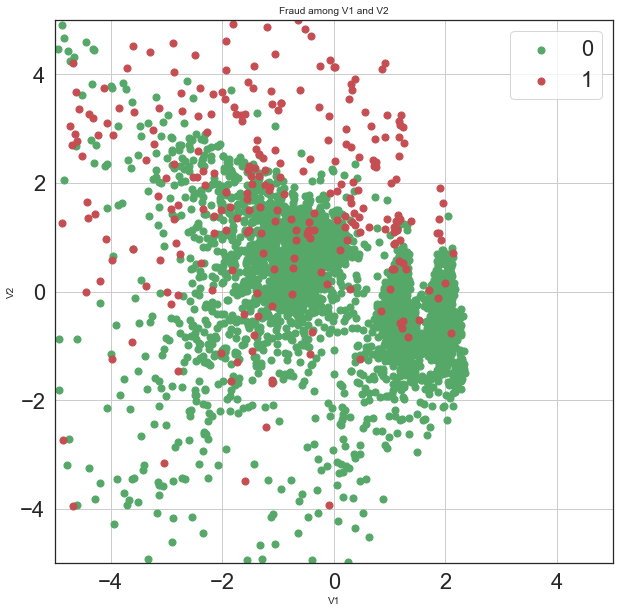

In [14]:
# plot new shape
plot_scatter(pd.concat([trans_train_sample, class_train_sample], axis=1))


New dataset shape approximately repeats the shape of our initial dataset.

## Training models

In [ ]:
# we use ROC AUC for scoring 
# function which plots roc curve
def plot_roc_auc(actual, pred):
    fpr, tpr, thresholds = roc_curve(actual, pred)
    plt.plot(fpr, tpr, 'r')
    # line under curve
    plt.plot([0, 1], [0, 1], 'b')
    plt.title(f'AUC: {auc(fpr, tpr)}')
    plt.show()

In [27]:
# Linear CVS
pipe_lcvs = Pipeline([('scale', StandardScaler()),
                   ('SVC',LinearSVC())])

# Gridsearch to determine the value of C
param_grid = {'SVC__C':np.arange(0.01,100,10)}
linear_SVC = GridSearchCV(pipe_lcvs,param_grid,cv=8, scoring='roc_auc', return_train_score=True)
linear_SVC.fit(trans_train_sample,class_train_sample)
print(linear_SVC.best_params_)
print(linear_SVC.cv_results_)

{'SVC__C': 0.01}
{'mean_fit_time': array([0.06735271, 0.40700406, 1.23421633, 0.65544528, 0.64953429,
       0.60275182, 0.83693963, 0.67491627, 0.75425431, 0.68941832]), 'std_fit_time': array([0.02496418, 0.04375943, 0.43251239, 0.08183626, 0.07761262,
       0.07203149, 0.33527929, 0.08689739, 0.13348393, 0.10230041]), 'mean_score_time': array([0.0057005 , 0.00641561, 0.01277596, 0.00763214, 0.01230469,
       0.00779018, 0.01168931, 0.006515  , 0.00698128, 0.00732327]), 'std_score_time': array([0.00117101, 0.00361665, 0.00615664, 0.00288798, 0.00386729,
       0.0026365 , 0.00870486, 0.00223383, 0.00170022, 0.0034017 ]), 'param_SVC__C': masked_array(data=[0.01, 10.01, 20.01, 30.01, 40.01, 50.01, 60.01, 70.01,
                   80.01, 90.01],
             mask=[False, False, False, False, False, False, False, False,
                   False, False],
       fill_value='?',
            dtype=object), 'params': [{'SVC__C': 0.01}, {'SVC__C': 10.01}, {'SVC__C': 20.01}, {'SVC__C': 30.01},

In [33]:
print(f'Best score on validation set: {linear_SVC.best_score_}')

Best score on validation set: 0.9790932364833559


In [31]:
# test set performance
pred_linear_SVC = linear_SVC.predict(trans_test)


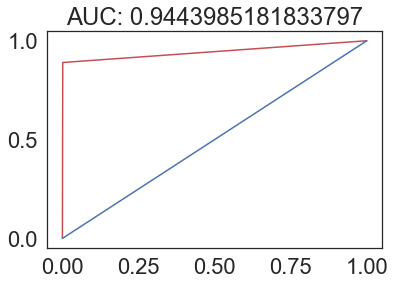

In [32]:
# plot the curve
plot_roc_auc(class_test, pred_linear_SVC)

In [17]:
# what params tthe model accepts
SVR().get_params().keys()

dict_keys(['C', 'cache_size', 'coef0', 'degree', 'epsilon', 'gamma', 'kernel', 'max_iter', 'shrinking', 'tol', 'verbose'])

In [18]:
# SVR
pipe_svr = Pipeline([('scale', StandardScaler()), ('SVR', SVR())])
params_grid = {'SVR__kernel': ['rbf'], 
                'SVR__C': [0.1, 1, 10, 100, 1000],  
                'SVR__gamma': [1, 0.1, 0.01, 0.001, 0.0001]}
inner_cv = KFold(n_splits=8, shuffle=True, random_state=42)
svr = GridSearchCV(pipe_svr, params_grid, cv=inner_cv, scoring='roc_auc', return_train_score=True)
svr.fit(trans_train_sample,class_train_sample)
print(svr.best_params_)
print(svr.cv_results_)
print(svr.best_score_)

{'SVR__C': 10, 'SVR__gamma': 0.001, 'SVR__kernel': 'rbf'}
{'mean_fit_time': array([1.56713307, 0.30542642, 0.15204495, 0.18449926, 0.22020489,
       1.55791768, 0.36786595, 0.18459213, 0.15457585, 0.17720181,
       1.61764157, 0.68684784, 0.64842489, 0.38988808, 0.38702551,
       2.56569475, 1.08462945, 1.53238812, 0.56453612, 0.27608481,
       1.7577087 , 0.97008324, 8.08951443, 2.76624095, 0.85726291]), 'std_fit_time': array([0.3899172 , 0.0252646 , 0.01267308, 0.02504945, 0.01876847,
       0.13764094, 0.02843543, 0.02038553, 0.02464585, 0.0131964 ,
       0.10283006, 0.10912487, 0.21622057, 0.15543014, 0.0972844 ,
       0.66492378, 0.25006449, 0.20806434, 0.06416133, 0.04557881,
       0.12315072, 0.08420197, 1.77682176, 0.25352695, 0.12535027]), 'mean_score_time': array([0.11950219, 0.03258717, 0.01879719, 0.02096415, 0.02385008,
       0.11543953, 0.0365063 , 0.01652423, 0.01603058, 0.02197507,
       0.12093142, 0.04811463, 0.04153499, 0.02734339, 0.02967438,
       0.25397

In [22]:
# test data
pred_svr = svr.predict(trans_test)

In [23]:
pred_svr

array([ 0.00271976,  0.02068475,  0.00159746, ...,  0.0471614 ,
       -0.01161185, -0.00798416])

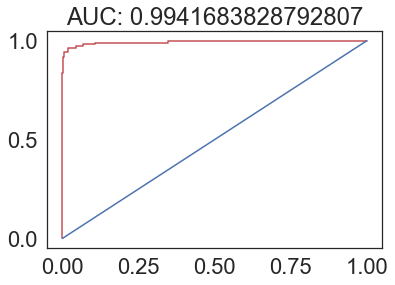

In [25]:
plot_roc_auc(class_test, pred_svr)

In [40]:
# Stochastic Gradient Descent classifier
pipe_sgd = Pipeline([('scale', StandardScaler()), ('SGDClassifier', SGDClassifier())])
param_grid_sgd = {"SGDClassifier__alpha": [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
              "SGDClassifier__penalty": ["none", "l1", "l2"]}
inner_cv = KFold(n_splits=8, shuffle=True, random_state=42)
sgdcl = GridSearchCV(pipe_sgd, param_grid_sgd, cv=inner_cv, scoring='roc_auc', return_train_score=True)
sgdcl.fit(trans_train_sample,class_train_sample)
print(sgdcl.best_params_)
print(sgdcl.cv_results_)
print(sgdcl.best_score_)

{'SGDClassifier__alpha': 0.1, 'SGDClassifier__penalty': 'l2'}
{'mean_fit_time': array([0.09638116, 0.05934966, 0.02911425, 0.06079465, 0.12913489,
       0.03374967, 0.03208569, 0.03375128, 0.01940018, 0.02167824,
       0.02211332, 0.01866275, 0.0403156 , 0.02184409, 0.01664448,
       0.02865273, 0.02063581, 0.01672068, 0.02067336, 0.04426557,
       0.02816984]), 'std_fit_time': array([0.07738303, 0.01796309, 0.00296648, 0.01577979, 0.03278797,
       0.00202472, 0.01106365, 0.00902829, 0.00201608, 0.00486111,
       0.0090303 , 0.00323063, 0.03479109, 0.00326104, 0.00236198,
       0.00463688, 0.00326782, 0.00278764, 0.00315286, 0.0092578 ,
       0.00571326]), 'mean_score_time': array([0.00879204, 0.00507727, 0.00633436, 0.00976679, 0.00594836,
       0.00785822, 0.0088205 , 0.00704032, 0.00581029, 0.0059984 ,
       0.00534004, 0.00574431, 0.00824741, 0.00591323, 0.00622743,
       0.00552067, 0.00494799, 0.00529265, 0.00528052, 0.0066686 ,
       0.00675726]), 'std_score_time': 

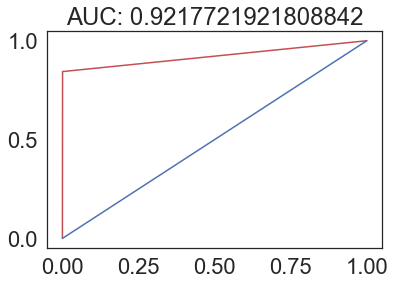

In [41]:
# test set
pred_linear_SGDCl = sgdcl.predict(trans_test)
# plot the curve
plot_roc_auc(class_test, pred_linear_SGDCl)

### Conclusion

Thus we trained three models with grid search parameters. The best class recognition is shown by Support Vector rergression around 98% on validation dataset and 99% on test dataset.
TODO: which pc contribute the most in fraud transaction selection?